<a href="https://colab.research.google.com/github/ArunK-ML/Learn---Image-processing-DL/blob/main/Image_processing.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. **Basic Preprocessing**

Before feeding images to a DL model:

**Resizing** → Make all images the same shape (e.g., 224×224 for ResNet).

**Normalization** → Scale pixel values (0–255 → 0–1 or mean-subtracted, std-normalized).

from tensorflow.keras.preprocessing.image import ImageDataGenerator
datagen = ImageDataGenerator(rescale=1./255)


**Grayscale conversion** → If color is not important.

**Noise removal** → e.g., Gaussian blur, median filtering.

**Contrast enhancement** → Histogram equalization / CLAHE.

# **2. Data Augmentation**

To increase dataset diversity and prevent overfitting:

**Geometric transforms** → rotation, flipping, translation, zoom, cropping.

**Color jittering** → brightness, contrast, saturation, hue shifts.

Random noise injection.

**Cutout / Mixup / CutMix** → advanced augmentation strategies.

Example:

from tensorflow.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.1,
    horizontal_flip=True,
    fill_mode='nearest'
)



# **3. Advanced Preprocessing**

For certain tasks:

**Edge detection (Sobel, Canny)** → good for feature emphasis.

**Segmentation masks** → for semantic segmentation.

**Fourier transforms / Wavelets** → frequency domain features.

**Super-resolution (ESRGAN)** → if dataset images are low quality.

# **4. Framework-Specific Tools**

**TensorFlow / Keras** → ImageDataGenerator, tf.image

**PyTorch** → torchvision.transforms

import torchvision.transforms as T

transform = T.Compose([
    T.Resize((224,224)),
    T.RandomHorizontalFlip(),
    T.RandomRotation(15),
    T.ToTensor(),
    T.Normalize(mean=[0.485,0.456,0.406], std=[0.229,0.224,0.225])
])


**Albumentations** → Very powerful augmentation library (fast, advanced).

# **5. Task-Specific Preprocessing**

**Classification** → normalization, augmentation.

**Object Detection** → keep aspect ratios, bounding box–aware augmentations.

**Segmentation** → apply same augmentation to image + mask.

**GANs / Image-to-Image** → scaling to [-1, 1], random crops.

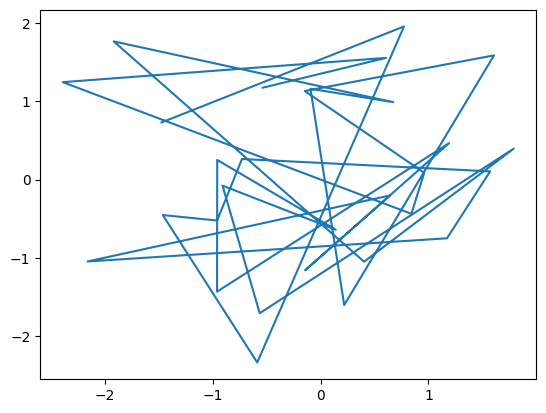

In [ ]:
import numpy as np

import matplotlib.pyplot as plt
x = np.random.normal(size=30)
y = np.random.normal(size=30)
plt.plot(x, y)
plt.show()

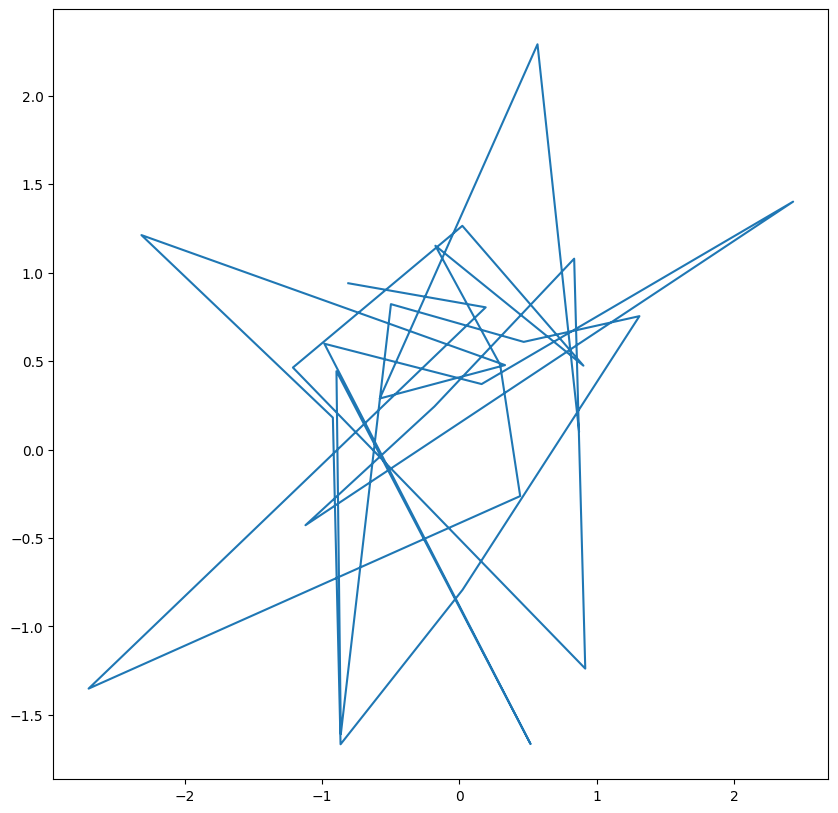

In [3]:
import numpy as np
import matplotlib.pyplot as plt

x = np.random.normal(size=30)
y = np.random.normal(size=30)

plt.figure(figsize=(10, 10),dpi=100)
plt.plot(x, y)
plt.show()

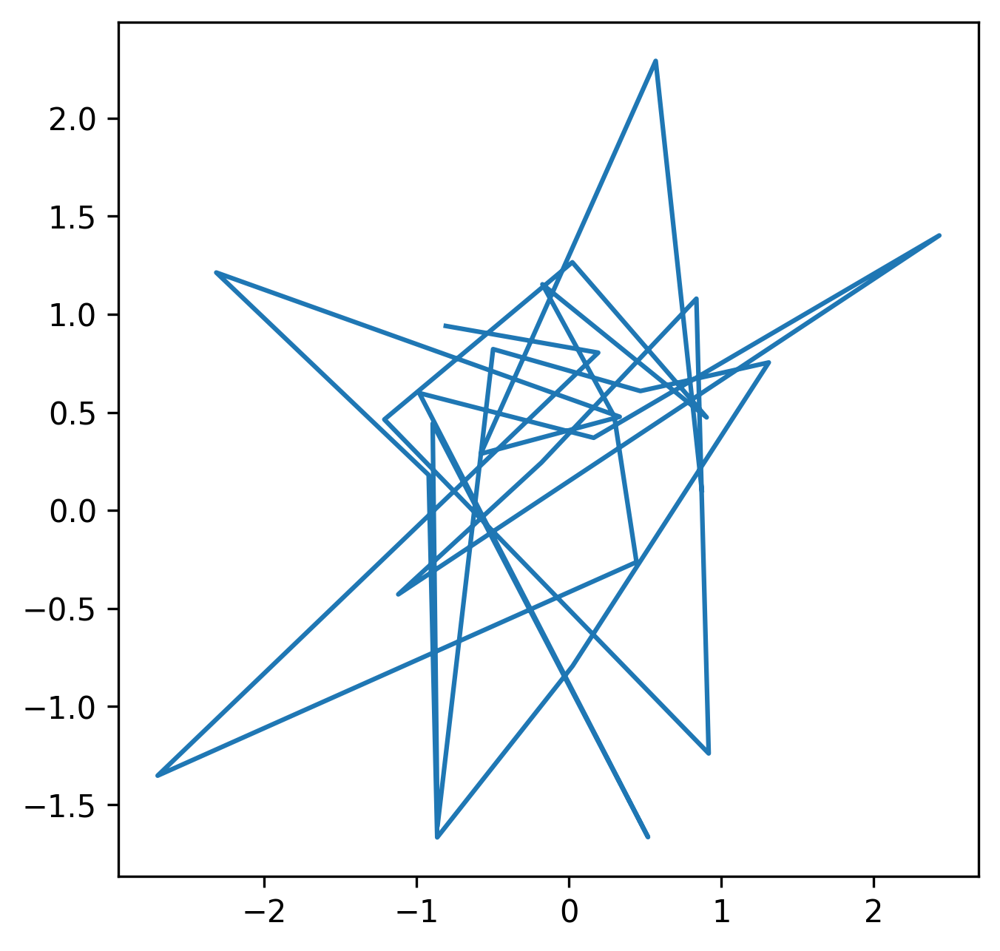

In [4]:
plt.figure(figsize=(5, 5),dpi=300)
plt.plot(x, y)
plt.show()

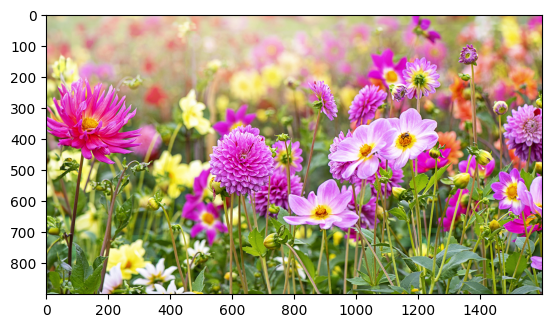

In [6]:
import matplotlib.pyplot as plt
import urllib.request
from PIL import Image
import numpy as np

url = 'https://cdn.mos.cms.futurecdn.net/JnPFeJ4pRF747aYwpu3buR.jpg'
with urllib.request.urlopen(url) as url_response:
    img = np.array(Image.open(url_response))

plt.imshow(img)
plt.show()

In [7]:
img.shape #row,column,3d

(900, 1600, 3)

In [8]:
img #it understands as 3d array

array([[[174, 198, 222],
        [196, 209, 199],
        [196, 199, 146],
        ...,
        [221,  94, 197],
        [197,  95, 194],
        [165, 137, 188]],

       [[202, 213, 199],
        [199, 195, 134],
        [202, 205, 138],
        ...,
        [235,  88, 205],
        [229,  80, 206],
        [230,  87, 179]],

       [[205, 201, 138],
        [203, 199, 125],
        [203, 198, 143],
        ...,
        [234,  92, 190],
        [226,  79, 193],
        [232,  88, 186]],

       ...,

       [[119, 139,  86],
        [165, 193, 142],
        [185, 208, 182],
        ...,
        [ 93,  67,  66],
        [ 87,  70,  80],
        [ 76,  81,  75]],

       [[105, 142,  62],
        [125, 168,  86],
        [140, 175, 117],
        ...,
        [102,  83, 102],
        [ 98,  88, 113],
        [ 73,  72,  78]],

       [[100, 133,  52],
        [104, 139,  55],
        [ 98, 137,  58],
        ...,
        [110,  89, 106],
        [ 93,  88, 110],
        [ 70,  58,  60]]

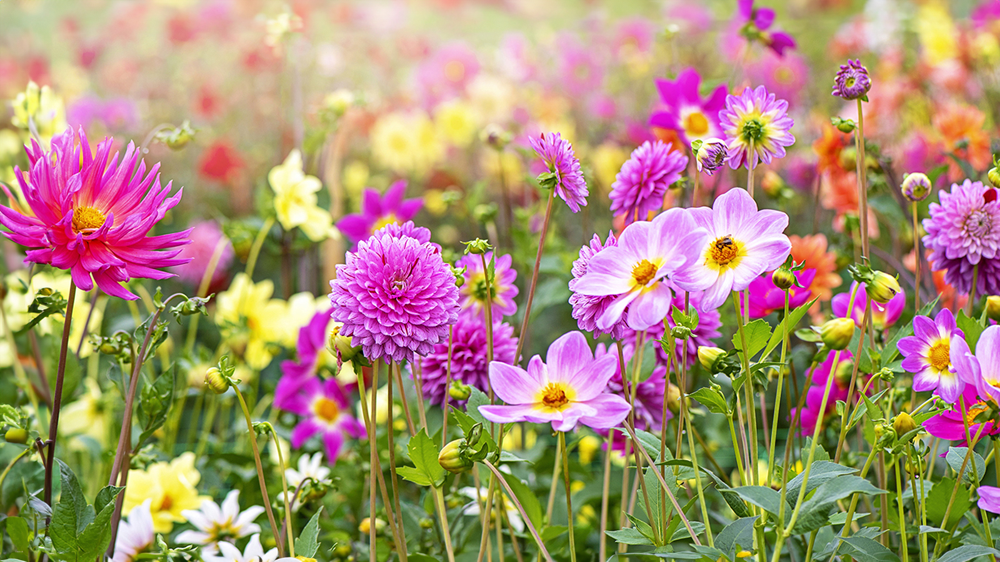

In [10]:
from PIL import Image
import urllib.request

url = 'https://cdn.mos.cms.futurecdn.net/JnPFeJ4pRF747aYwpu3buR.jpg'
with urllib.request.urlopen(url) as url_response:
    img = Image.open(url_response)
img

In [11]:
img.size #width, height

(1600, 900)

In [12]:
img.mode, img.format, img.width, img.height, img.filename, img.info, img.palette

('RGB',
 'JPEG',
 1600,
 900,
 '',
 {'exif': b'Exif\x00\x00II*\x00\x08\x00\x00\x00\x10\x00\x00\x01\x03\x00\x01\x00\x00\x00\xc0\x10\x00\x00\x01\x01\x03\x00\x01\x00\x00\x00*\x0b\x00\x00\x02\x01\x03\x00\x03\x00\x00\x00\xce\x00\x00\x00\x06\x01\x03\x00\x01\x00\x00\x00\x02\x00\x00\x00\x0f\x01\x02\x00\x12\x00\x00\x00\xd4\x00\x00\x00\x10\x01\x02\x00\x0b\x00\x00\x00\xe6\x00\x00\x00\x12\x01\x03\x00\x01\x00\x00\x00\x01\x00\x00\x00\x15\x01\x03\x00\x01\x00\x00\x00\x03\x00\x00\x00\x1a\x01\x05\x00\x01\x00\x00\x00\xf1\x00\x00\x00\x1b\x01\x05\x00\x01\x00\x00\x00\xf9\x00\x00\x00(\x01\x03\x00\x01\x00\x00\x00\x02\x00\x00\x001\x01\x02\x00"\x00\x00\x00\x01\x01\x00\x002\x01\x02\x00\x14\x00\x00\x00#\x01\x00\x00;\x01\x02\x00\x19\x00\x00\x007\x01\x00\x00\x98\x82\x02\x00\x14\x00\x00\x00P\x01\x00\x00i\x87\x04\x00\x01\x00\x00\x00d\x01\x00\x00(\x04\x00\x00\x08\x00\x08\x00\x08\x00NIKON CORPORATION\x00NIKON D750\x00\xc0\xc6-\x00\x10\'\x00\x00\xc0\xc6-\x00\x10\'\x00\x00Adobe Photoshop 25.12 (Macintosh)\x002025:02:27 1

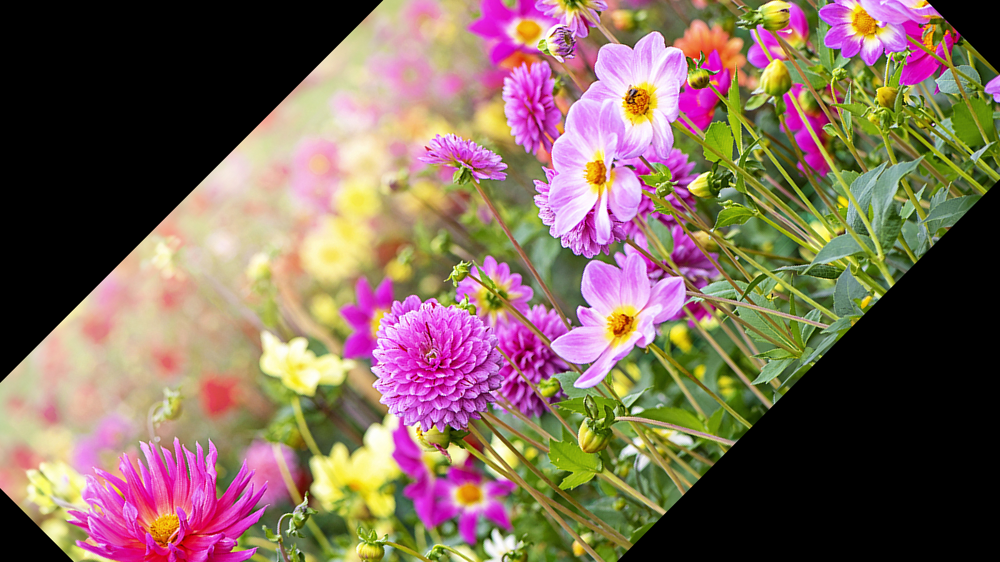

In [13]:
img.rotate(45)

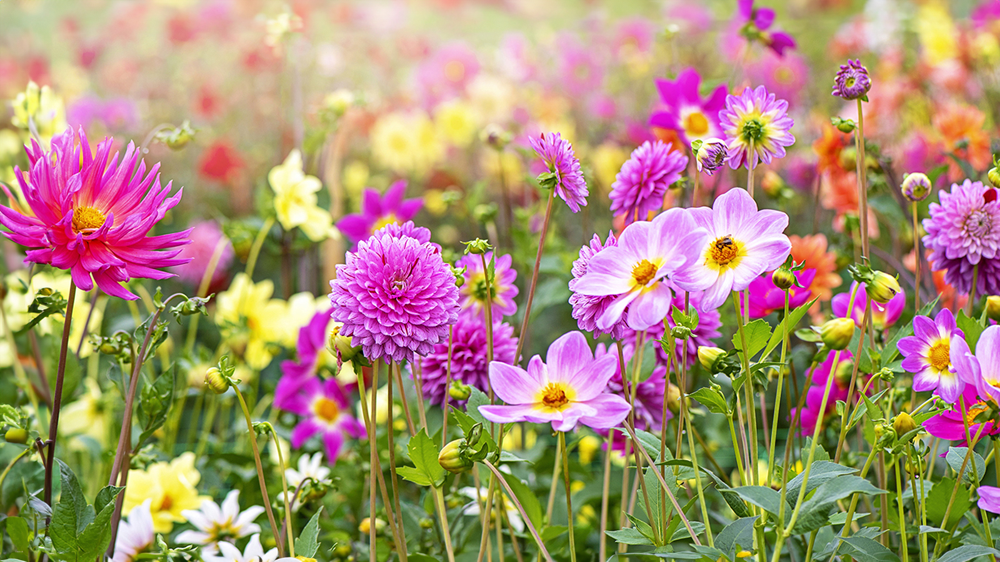

In [14]:
img

In [16]:
img.getpixel((1345, 899)) # Using valid coordinates

(109, 129, 92)

In [18]:
pict = img.load()
pict[1345,899]

(109, 129, 92)

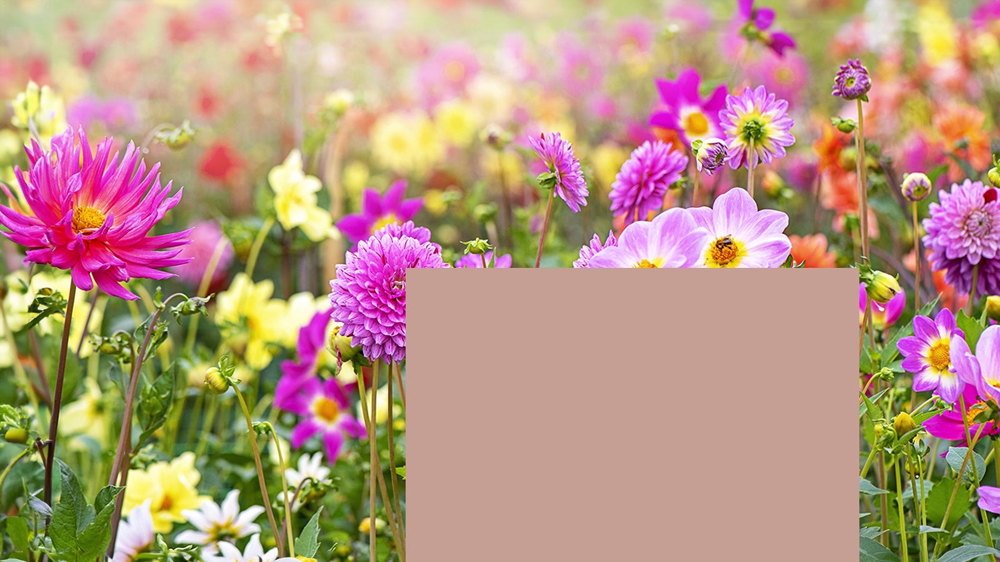

In [20]:
for w in range(649,1375):
  for h in range(429,900): # Adjusted range for height
    pict[w,h] = (197,158,148)
img

In [22]:
from PIL import Image
import urllib.request
import numpy as np

url = 'https://cdn.mos.cms.futurecdn.net/JnPFeJ4pRF747aYwpu3buR.jpg'
with urllib.request.urlopen(url) as url_response:
    img = Image.open(url_response)

pict = img.load() # loaded the img address into pict
width = img.width
height = img.height
for w in range(width//2,width):
  for h in range(0,height):
    pict[w,h]=(0,255,255)

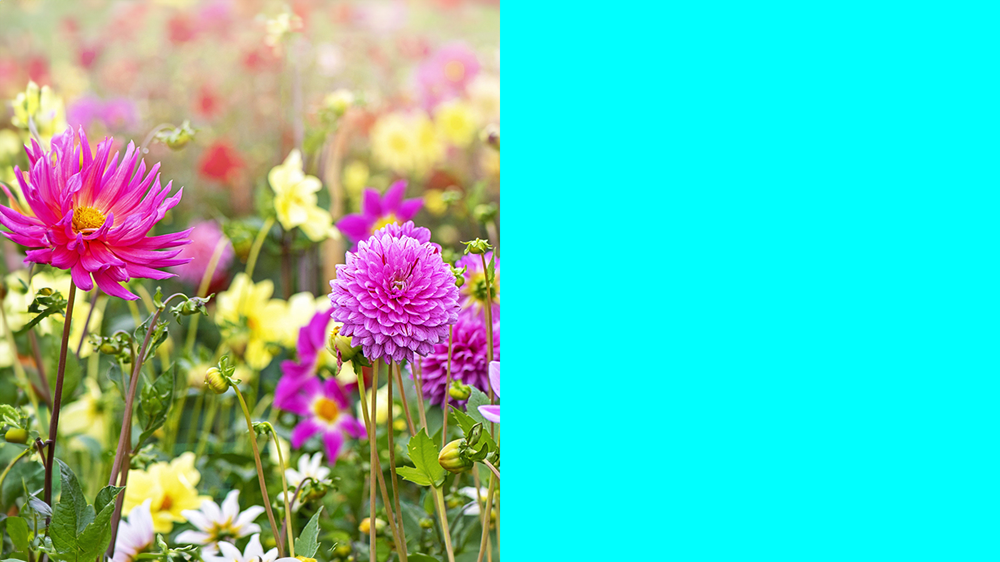

In [23]:
img

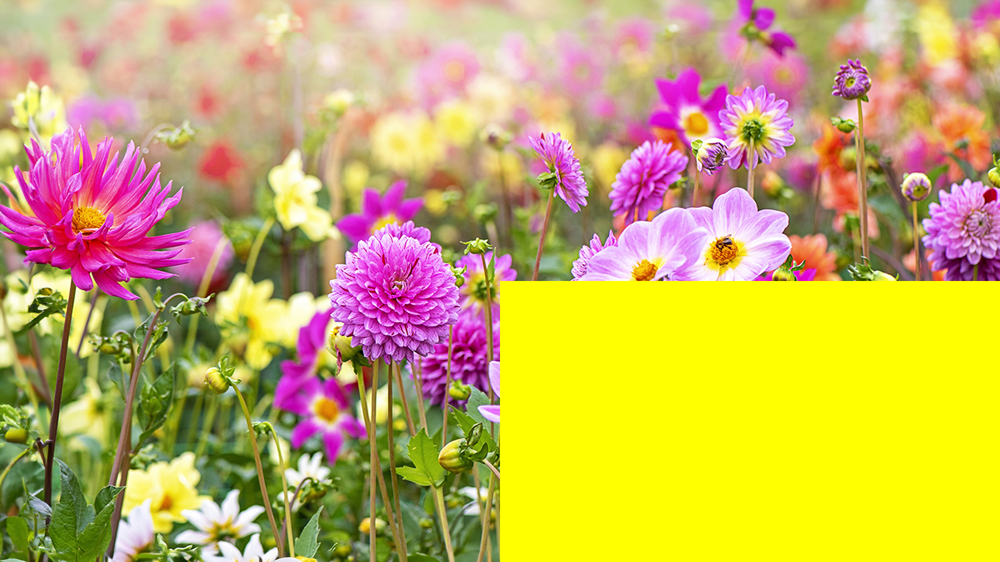

In [25]:
from PIL import Image
import urllib.request

url = 'https://cdn.mos.cms.futurecdn.net/JnPFeJ4pRF747aYwpu3buR.jpg'
with urllib.request.urlopen(url) as url_response:
    img = Image.open(url_response)

pict = img.load() # loaded the img address into pict
width = img.width
height = img.height
for w in range(width//2,width):
  for h in range(height//2,height):
    pict[w,h]=(255,255,0)
img

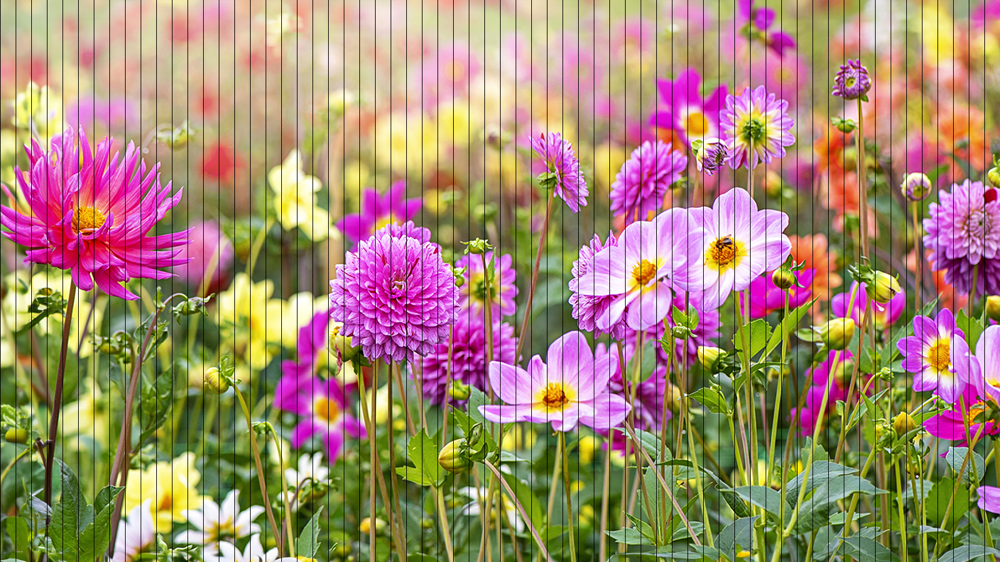

In [27]:
from PIL import Image
import urllib.request

url = 'https://cdn.mos.cms.futurecdn.net/JnPFeJ4pRF747aYwpu3buR.jpg'
with urllib.request.urlopen(url) as url_response:
    img = Image.open(url_response)

pict = img.load() # loaded the img address into pict
width = img.width
height = img.height
for w in range(0,width):
  if w%25==0:
    for h in range(0,height):
      pict[w,h]=(0,0,0)
img

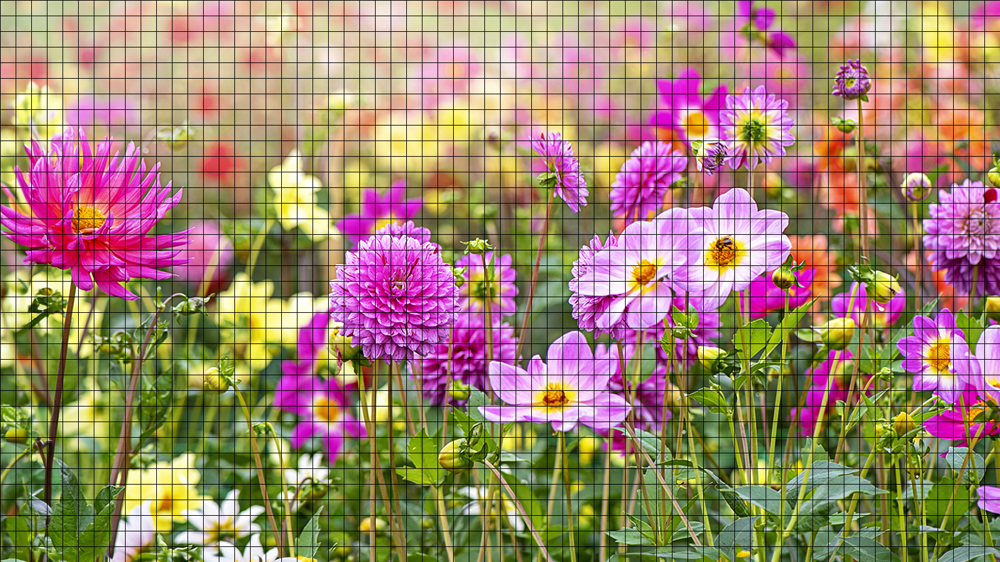

In [28]:
url = 'https://cdn.mos.cms.futurecdn.net/JnPFeJ4pRF747aYwpu3buR.jpg'
with urllib.request.urlopen(url) as url_response:
    img = Image.open(url_response)

pict = img.load() # loaded the img address into pict
width = img.width
height = img.height
for w in range(0,width):
    for h in range(0,height):
      if h%25==0:
        pict[w,h]=(0,0,0)
      if w%25==0:
        pict[w,h]=(0,0,0)
img